/Users/tanmay/opt/anaconda3/envs/cs269/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


/Users/tanmay/Desktop/Fall 2022/RL/assignment-2022fall/assignment3-project/core
/Users/tanmay/Desktop/Fall 2022/RL/assignment-2022fall/assignment3-project/core
pygame 2.1.2 (SDL 2.0.18, Python 3.7.13)
Hello from the pygame community. https://www.pygame.org/contribute.html


Successfully registered the following environments: ['MetaDrive-validation-v0', 'MetaDrive-10env-v0', 'MetaDrive-100envs-v0', 'MetaDrive-1000envs-v0', 'SafeMetaDrive-validation-v0', 'SafeMetaDrive-10env-v0', 'SafeMetaDrive-100envs-v0', 'SafeMetaDrive-1000envs-v0', 'MARLTollgate-v0', 'MARLBottleneck-v0', 'MARLRoundabout-v0', 'MARLIntersection-v0', 'MARLParkingLot-v0', 'MARLMetaDrive-v0'].
Successfully registered MetaDrive environments:  ['MetaDrive-Tut-Easy-v0', 'MetaDrive-Tut-Hard-v0', 'MetaDrive-Tut-1Env-v0', 'MetaDrive-Tut-5Env-v0', 'MetaDrive-Tut-10Env-v0', 'MetaDrive-Tut-20Env-v0', 'MetaDrive-Tut-50Env-v0', 'MetaDrive-Tut-100Env-v0', 'MetaDrive-Tut-Test-v0', 'MetaDrive-MARL-v0']
{'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 22.940
Evaluating 1/1 episodes. We are in 101/1000 steps. Current e

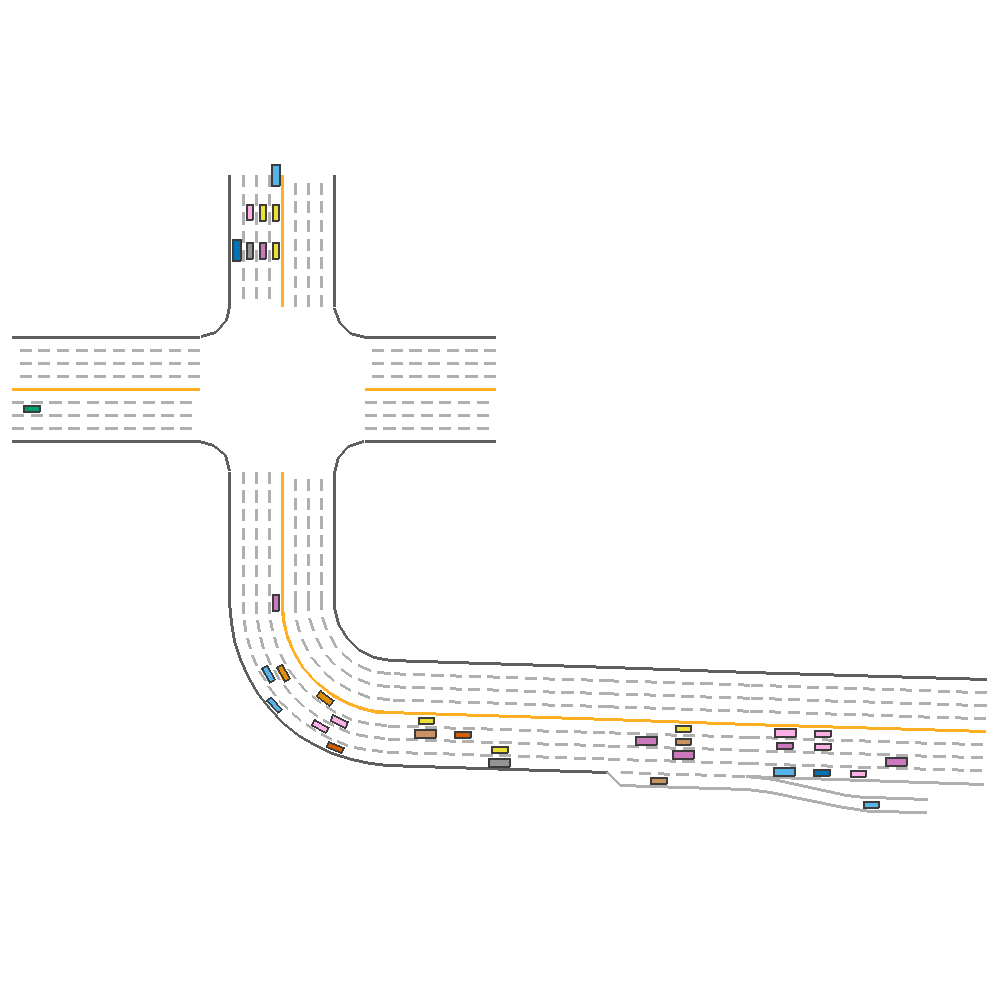

TD3 agent achieves 340.9188640706961 return in MetaDrive Hard environment.


In [1]:
from core.envs import make_envs
import gym
from vis import TD3Policy, evaluate, animate
import pygame
import random
import numpy as np

env_name = "MetaDrive-Tut-Hard-v0"
policy = TD3Policy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-test-rand-v1/td3/",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":50, "traffic_density": 0.3,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.map_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [2]:
path = "./td3_trained_on_gen_env.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

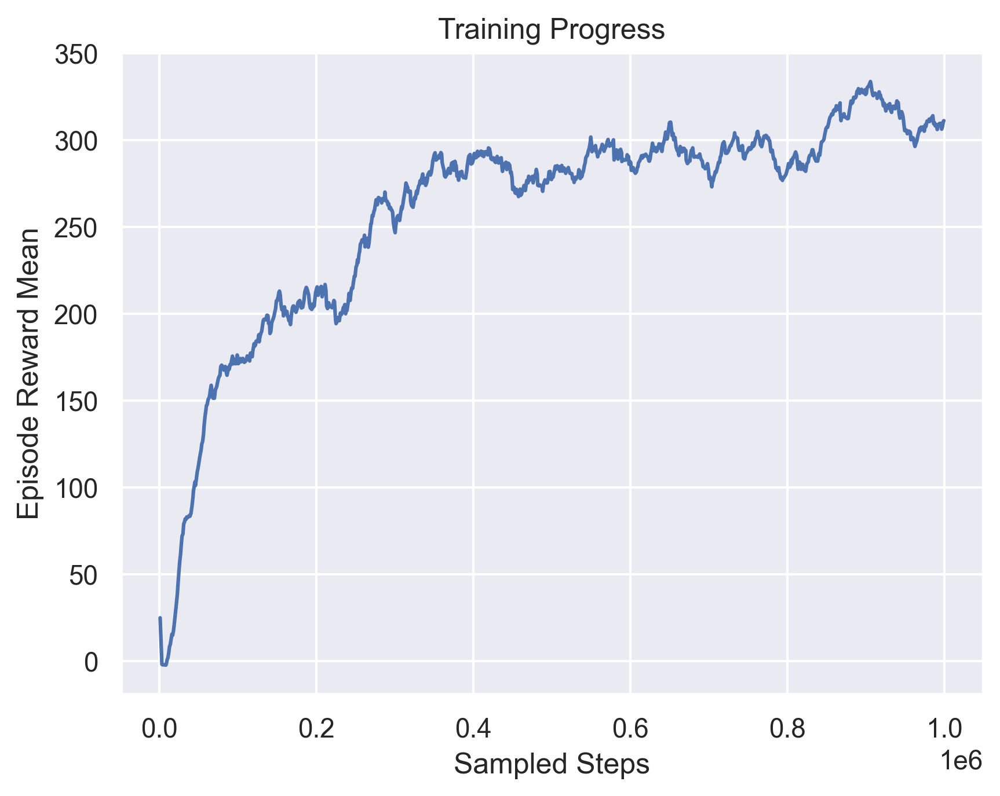

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-rand-v1/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-td3-general.png', format='png', dpi=300, bbox_inches="tight")


Cannot re-register id: MetaDrive-Tut-Easy-v0
{'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}


:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 26.399
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 77.765
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 110.620
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 128.626
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 140.745
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 154.863
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 167.886
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 178.497
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 188.576
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 201.112
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 232.505
Evaluating 

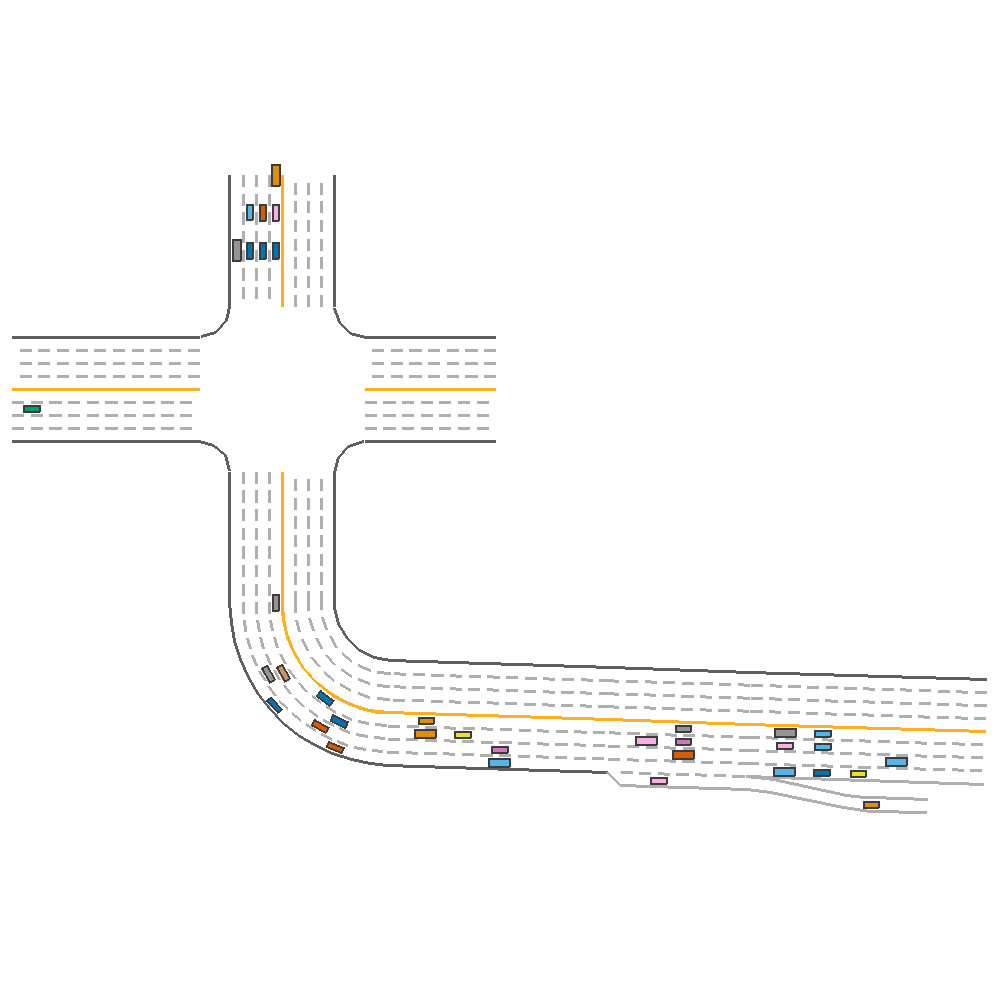

TD3 agent achieves 335.27706008322144 return in MetaDrive Hard environment.


In [4]:
from core.envs import make_envs
import gym
from vis import TD3Policy, evaluate, animate
import pygame
import random
import numpy as np

env_name = "MetaDrive-Tut-Hard-v0"
policy = TD3Policy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-td3combine-expt3/MetaDrive-Gen-v3/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":50, "traffic_density": 0.3,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.map_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [5]:
path = "./td3_trained_chained_1.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

Cannot re-register id: MetaDrive-Tut-Easy-v0
{'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}


:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 25.490
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 71.474
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 103.411
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 118.008
Evaluating 1/1 episodes. Episode is done in 223 steps. Episode reward: 125.586


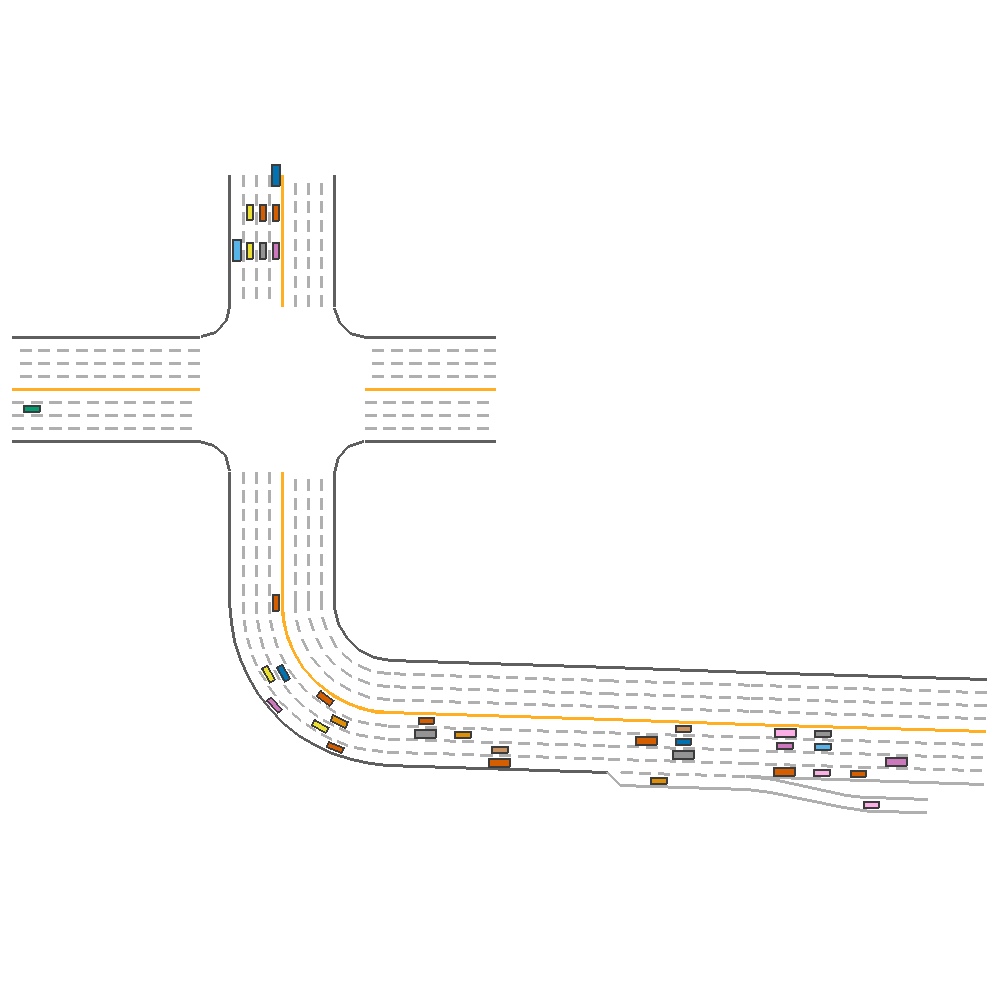

TD3 agent achieves 125.58631607311233 return in MetaDrive Hard environment.


In [6]:
from core.envs import make_envs
import gym
from vis import TD3Policy, evaluate, animate
import pygame
import random
import numpy as np

env_name = "MetaDrive-Tut-Hard-v0"
policy = TD3Policy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-td3combine-expt_with_safe/MetaDrive-Gen-Next-v2/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":50, "traffic_density": 0.3,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.map_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [7]:
path = "./td3_trained_chained_2.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

/Users/tanmay/Desktop/Fall 2022/RL/assignment-2022fall/assignment3-project/core
Cannot re-register id: MetaDrive-Tut-Easy-v0
{'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}


:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 29.046
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 79.523
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 104.667
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 130.095
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 153.635
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 179.270
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 196.632
Evaluating 1/1 episodes. Episode is done in 385 steps. Episode reward: 204.079


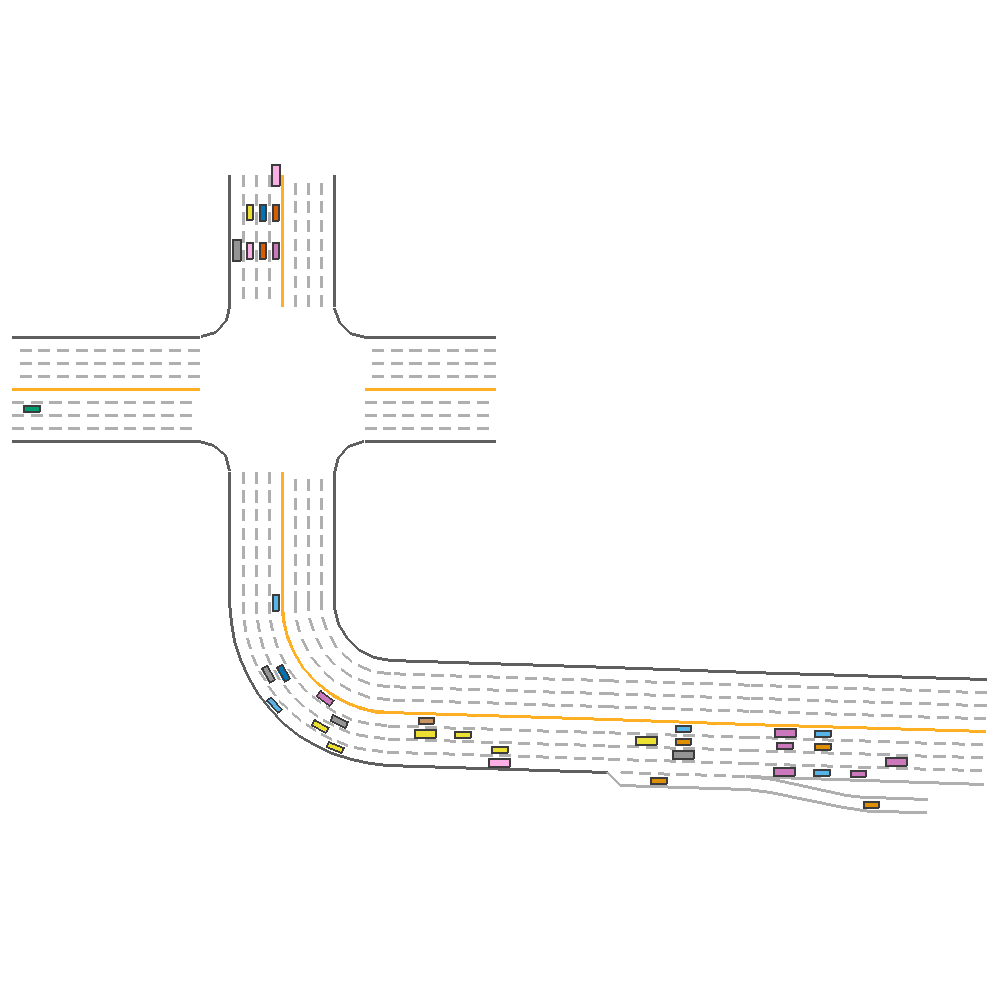

TD3 agent achieves 204.0793873023362 return in MetaDrive Hard environment.


In [8]:
from core.envs import make_envs
import gym
from vis_bn1 import TD3Policy, evaluate, animate
import pygame
import random
import numpy as np

env_name = "MetaDrive-Tut-Hard-v0"
policy = TD3Policy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-testbn1/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":50, "traffic_density": 0.3,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.map_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [9]:
path = "./td3_bn1.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

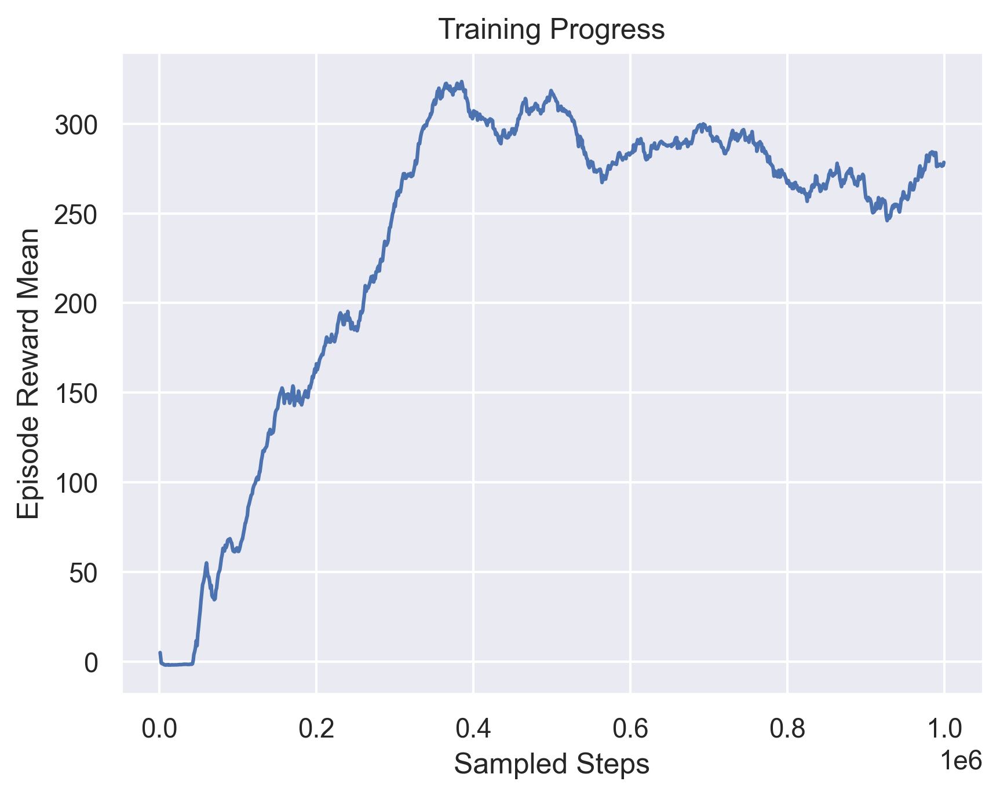

In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-testbn1/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-td3-bn1.png', format='png', dpi=300, bbox_inches="tight")

/Users/tanmay/Desktop/Fall 2022/RL/assignment-2022fall/assignment3-project/core
Cannot re-register id: MetaDrive-Tut-Easy-v0
{'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}


:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 24.736
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 67.816
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 101.168
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 126.716
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 149.007
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 166.475
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 180.714
Evaluating 1/1 episodes. Episode is done in 386 steps. Episode reward: 183.065


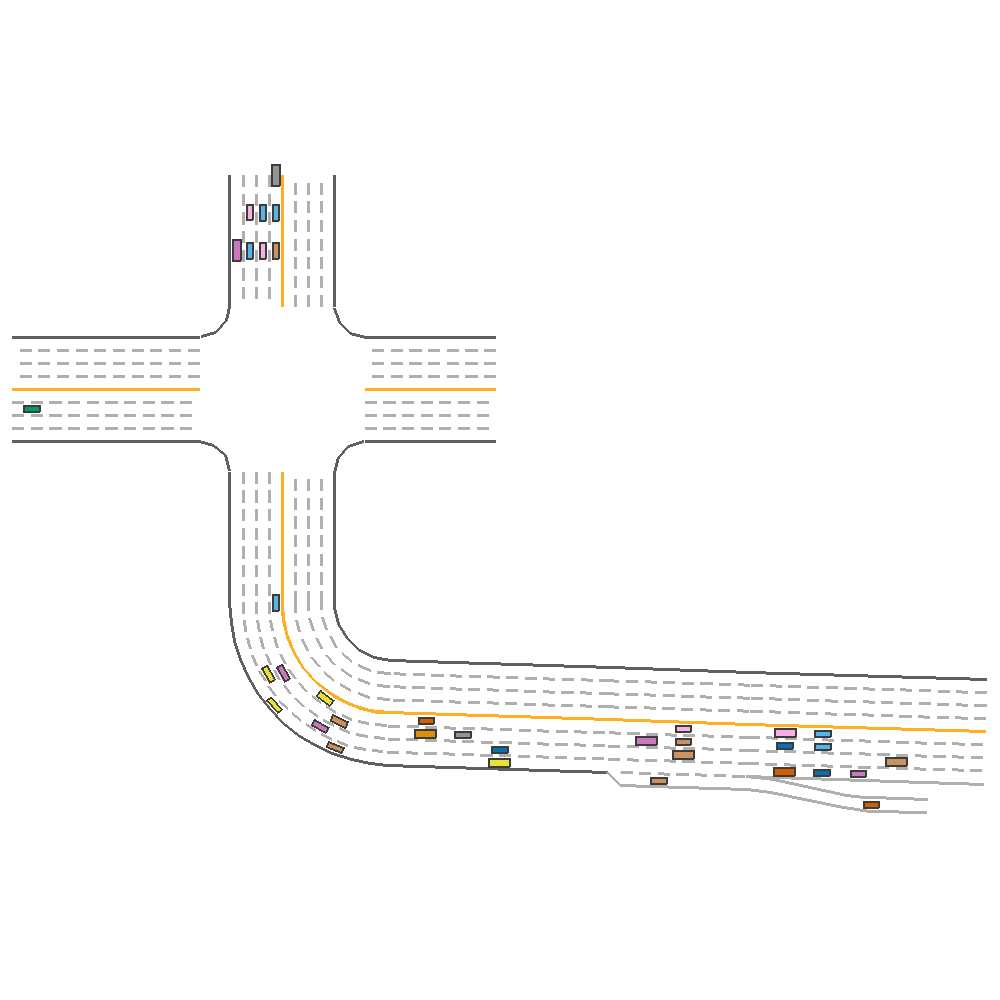

TD3 agent achieves 183.06542284292567 return in MetaDrive Hard environment.


In [11]:
from core.envs import make_envs
import gym
from vis_bn5 import TD3Policy, evaluate, animate
import pygame
import random
import numpy as np

env_name = "MetaDrive-Tut-Hard-v0"
policy = TD3Policy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-testbn5/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":50, "traffic_density": 0.3,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.map_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [12]:
path = "./td3_bn5.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

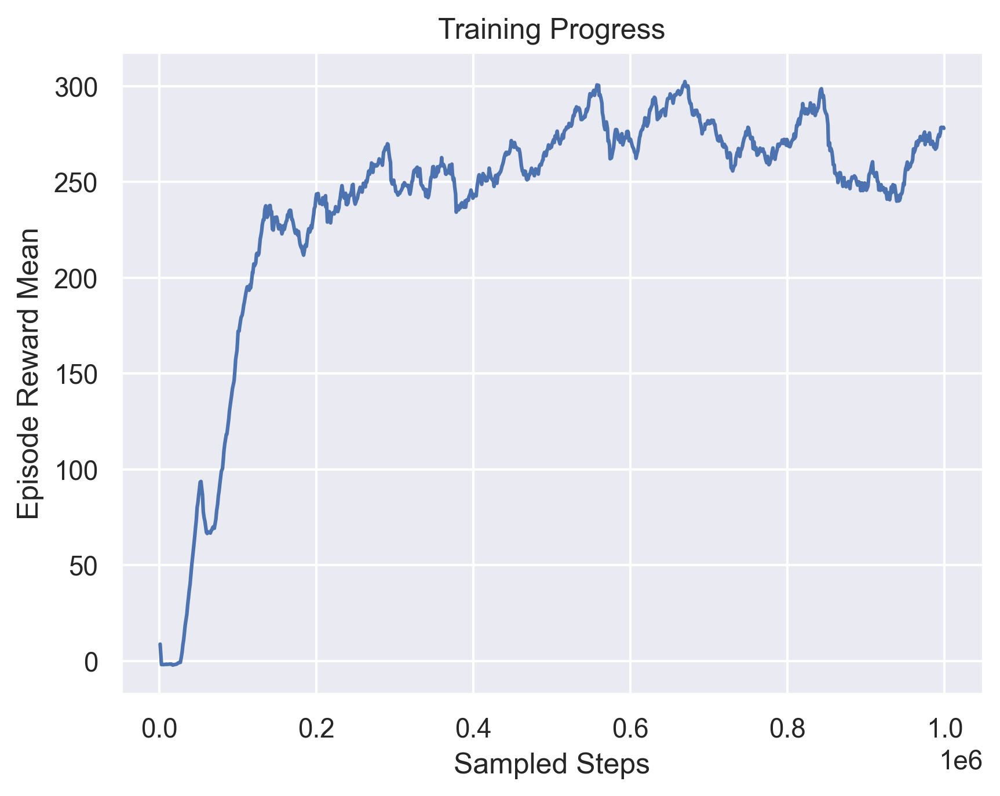

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-testbn5/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-td3-bn5.png', format='png', dpi=300, bbox_inches="tight")

/Users/tanmay/Desktop/Fall 2022/RL/assignment-2022fall/assignment3-project/core
Cannot re-register id: MetaDrive-Tut-Easy-v0
{'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}


:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 27.724
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 85.315
Evaluating 1/1 episodes. Episode is done in 107 steps. Episode reward: 83.656


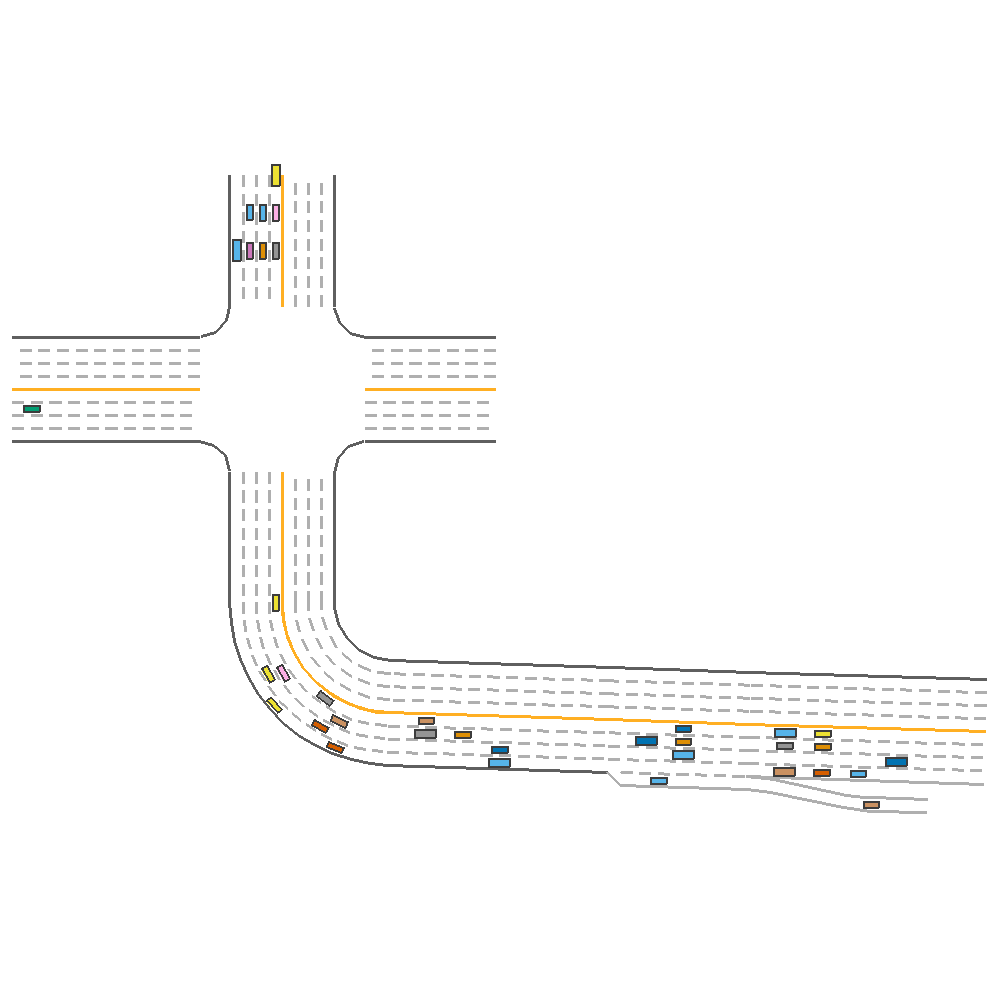

TD3 agent achieves 83.65587076487203 return in MetaDrive Hard environment.


In [15]:
from core.envs import make_envs
import gym
from vis_bn6 import TD3Policy, evaluate, animate
import pygame
import random
import numpy as np

env_name = "MetaDrive-Tut-Hard-v0"
policy = TD3Policy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-testbn6/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":50, "traffic_density": 0.3,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.map_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [16]:
path = "./td3_bn6.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

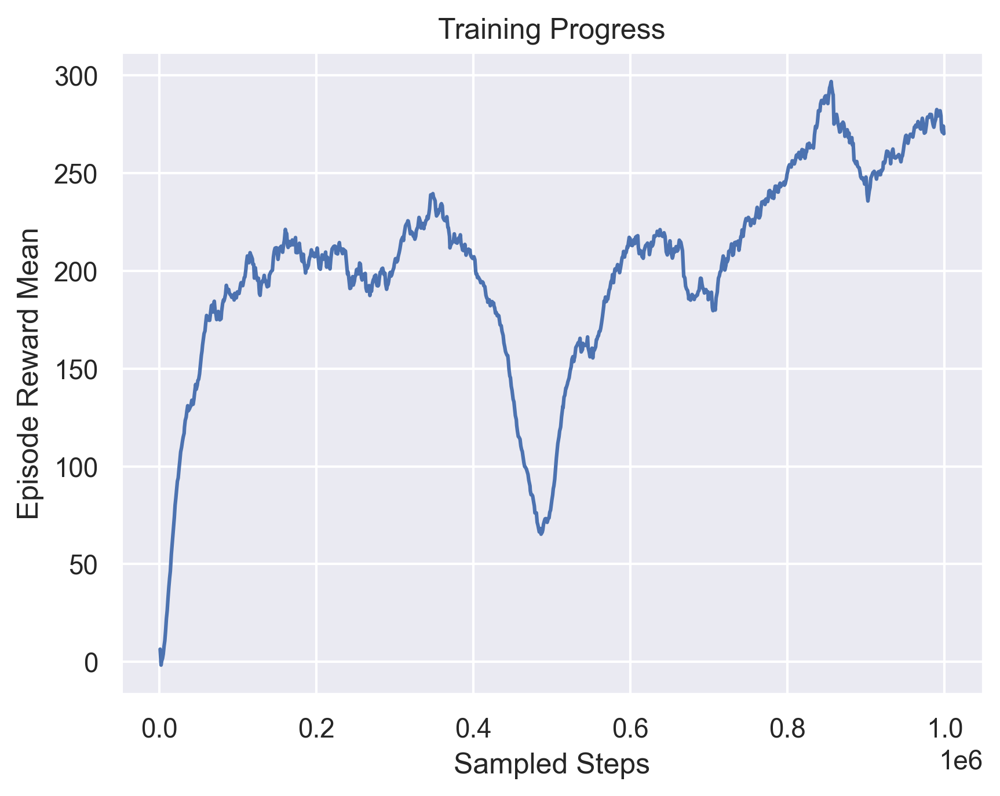

In [17]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-testbn6/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-td3-bn6.png', format='png', dpi=300, bbox_inches="tight")

Cannot re-register id: MetaDrive-Tut-Easy-v0
{'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}


:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 20.637
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 44.396
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 63.527
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 89.082
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 107.518
Evaluating 1/1 episodes. Episode is done in 269 steps. Episode reward: 108.544


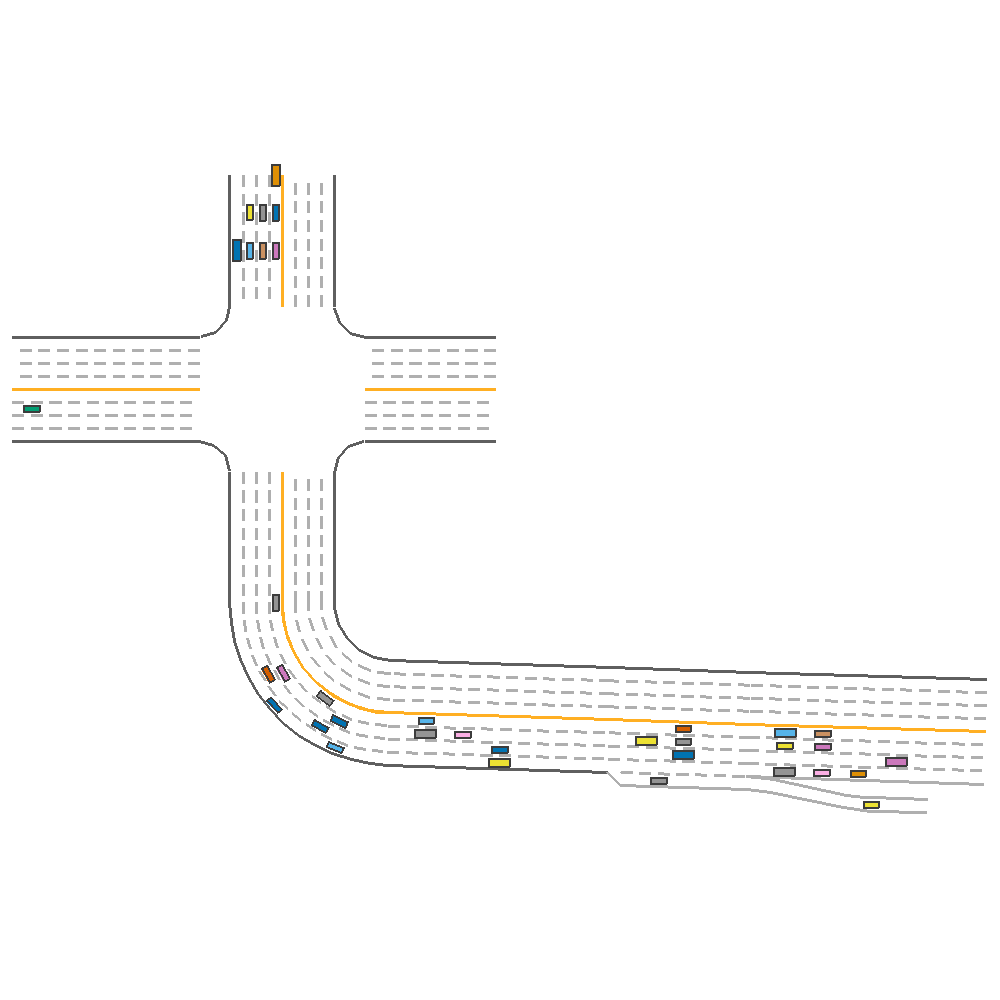

TD3 agent achieves 108.5444615188058 return in MetaDrive Hard environment.


In [18]:
from core.envs import make_envs
import gym
from vis import TD3Policy, evaluate, animate
import pygame
import random
import numpy as np

env_name = "MetaDrive-Tut-Hard-v0"
policy = TD3Policy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-Expt-Safe-Combine/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":50, "traffic_density": 0.3,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.map_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

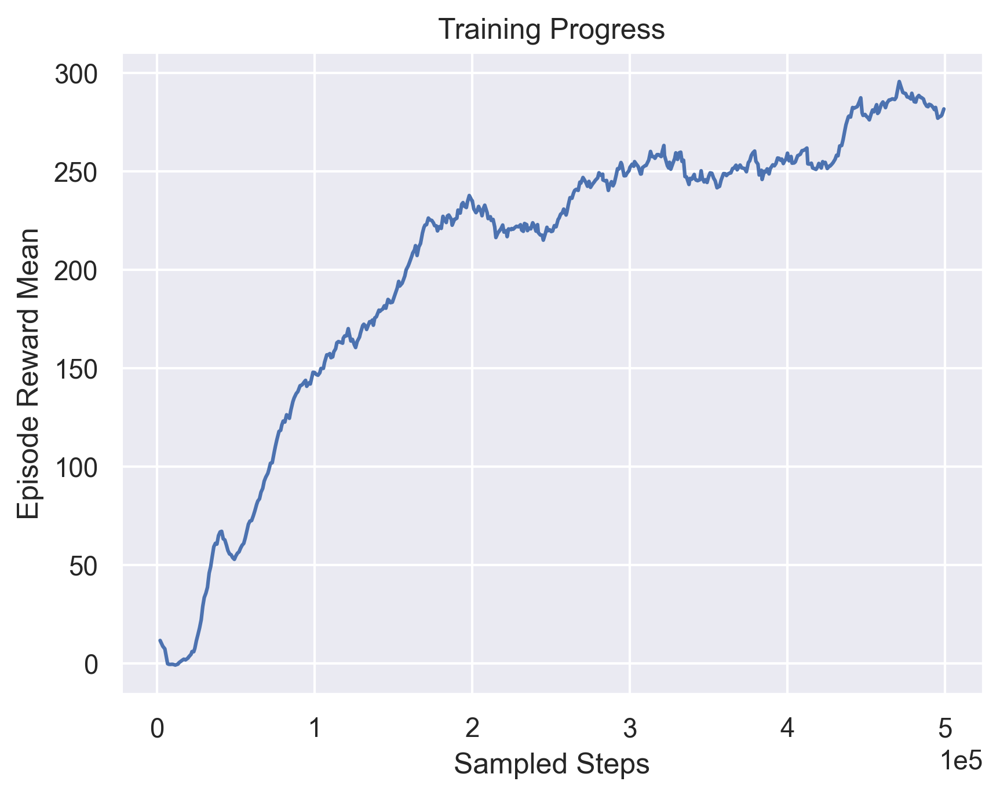

In [6]:
#AdamW optimizer added
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-adamW/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-adamW.png', format='png', dpi=300, bbox_inches="tight")

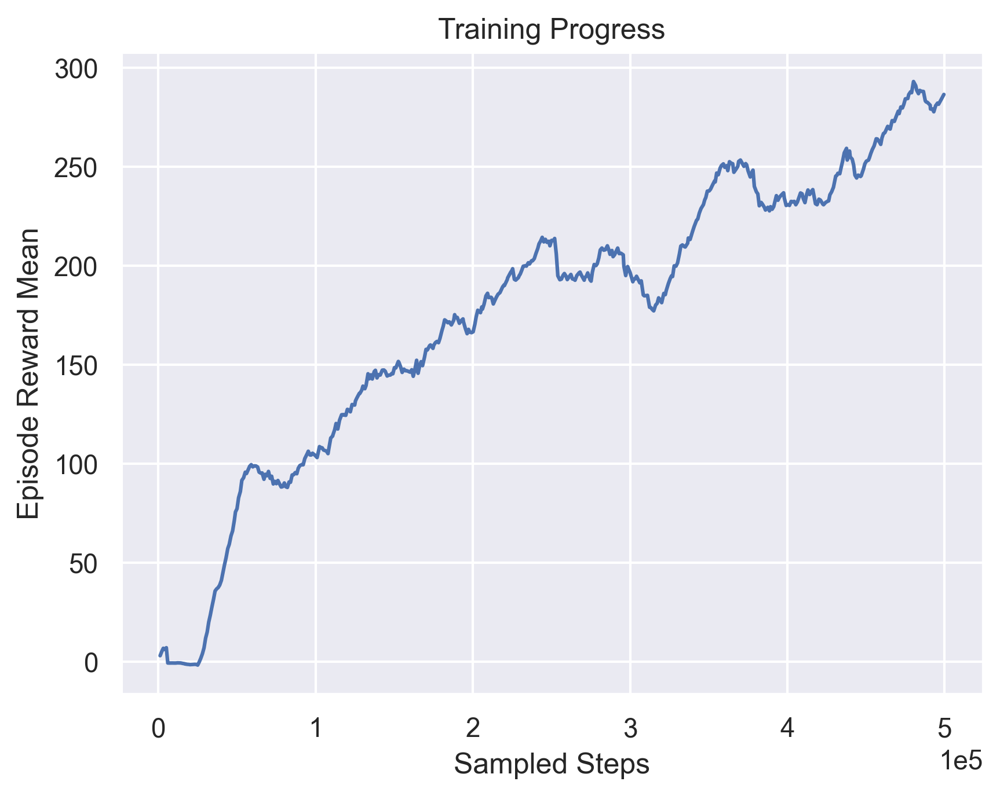

In [7]:
#Actor optimised with start = 5000
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv-colab/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-conv-5000.png', format='png', dpi=300, bbox_inches="tight")

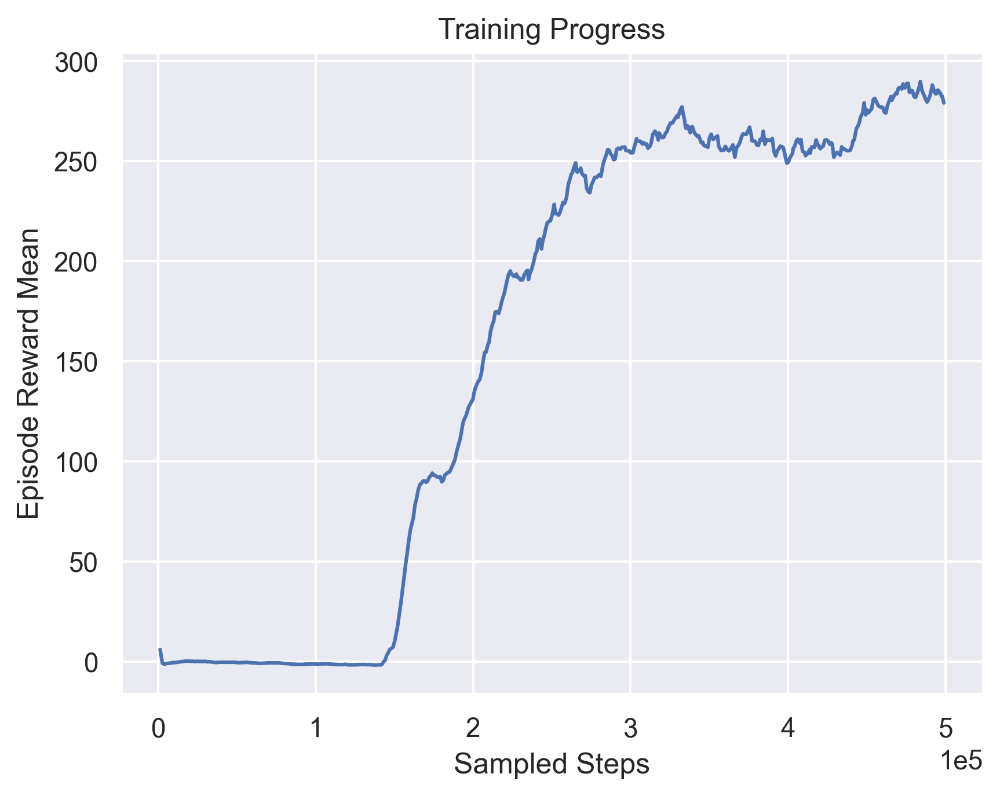

In [8]:
#Actor optimized with start = 1000
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv2-colab/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-conv-1000.png', format='png', dpi=300, bbox_inches="tight")

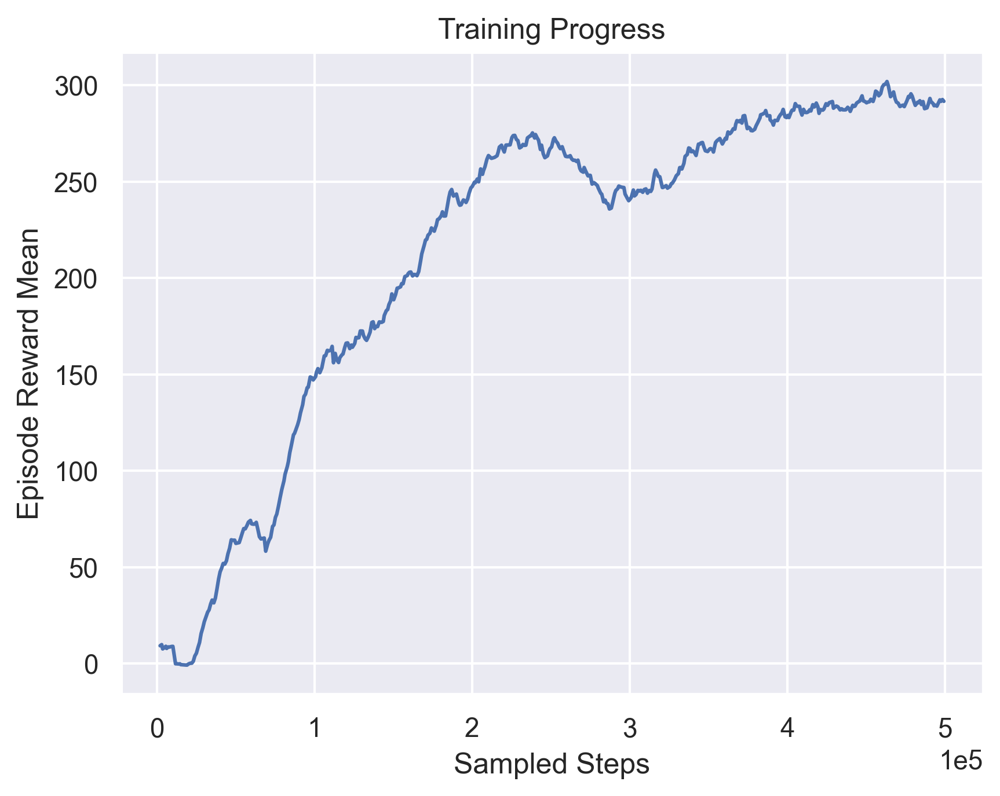

In [11]:
#Actor optimized with start = 10000
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv3-colab/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-conv-10000.png', format='png', dpi=300, bbox_inches="tight")

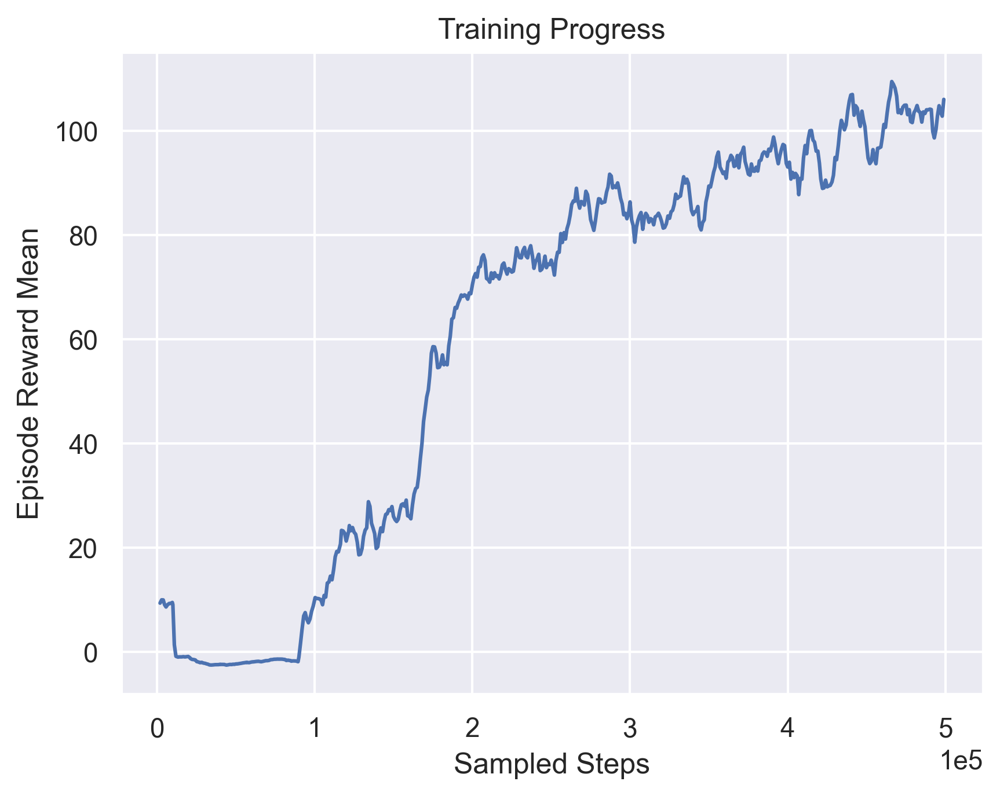

In [12]:
#Critic conv
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv-colab-critic/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-conv-critic.png', format='png', dpi=300, bbox_inches="tight")

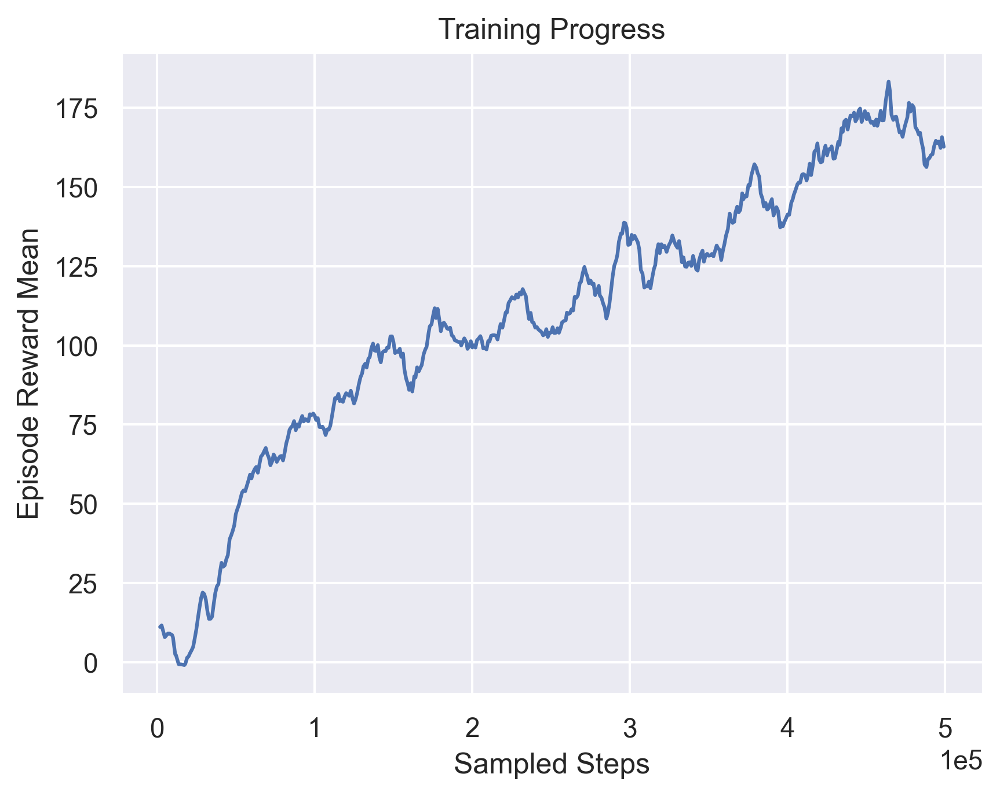

In [13]:
#Critic + Actor conv
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv-colab-both/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-conv-both.png', format='png', dpi=300, bbox_inches="tight")

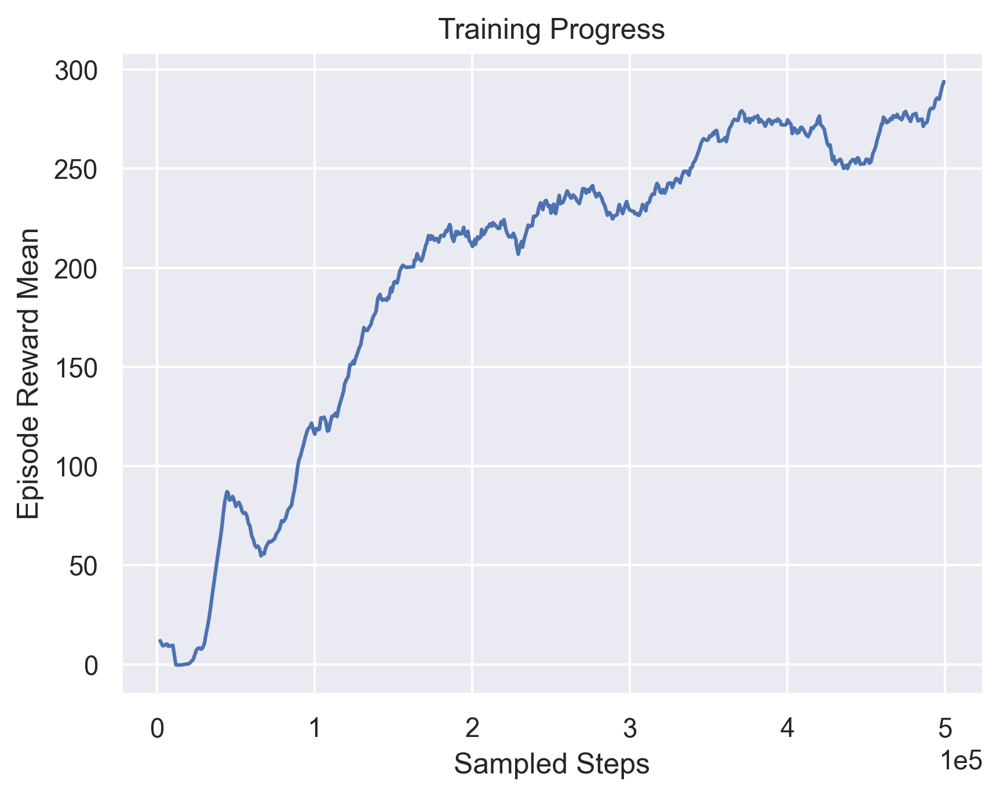

In [14]:
#Actor conv with dropout
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv-colab-actor-dropout/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-conv-actor-dropout.png', format='png', dpi=300, bbox_inches="tight")

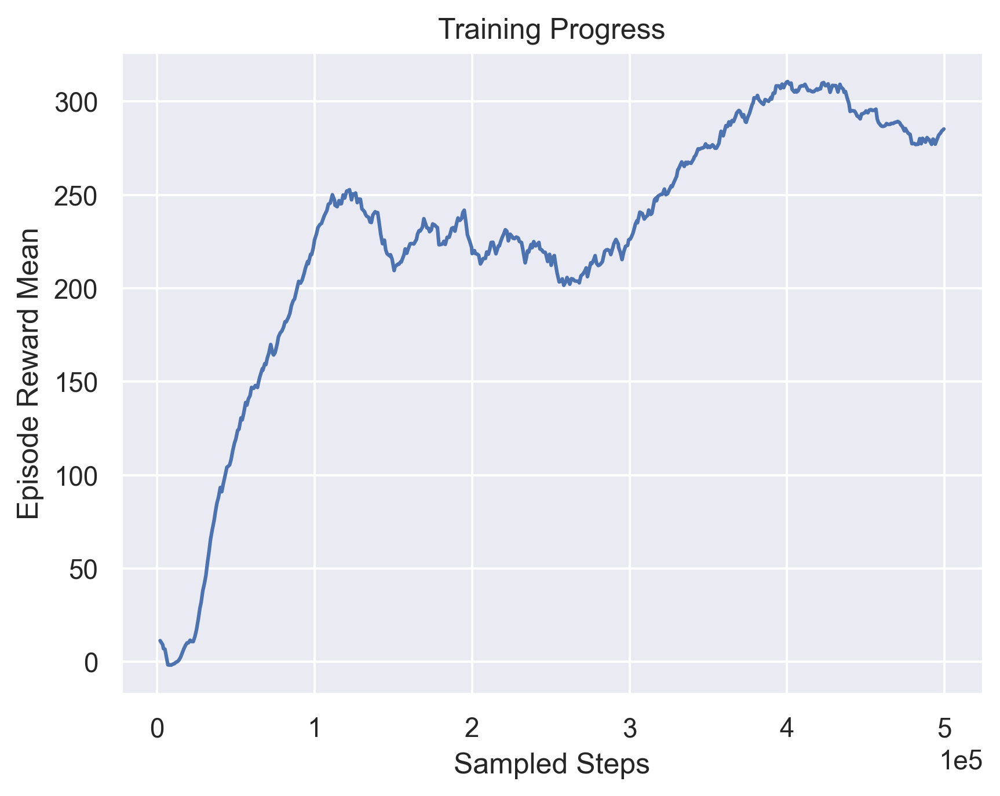

In [15]:
#Leaky relu activation
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-leaky/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-leaky.png', format='png', dpi=300, bbox_inches="tight")

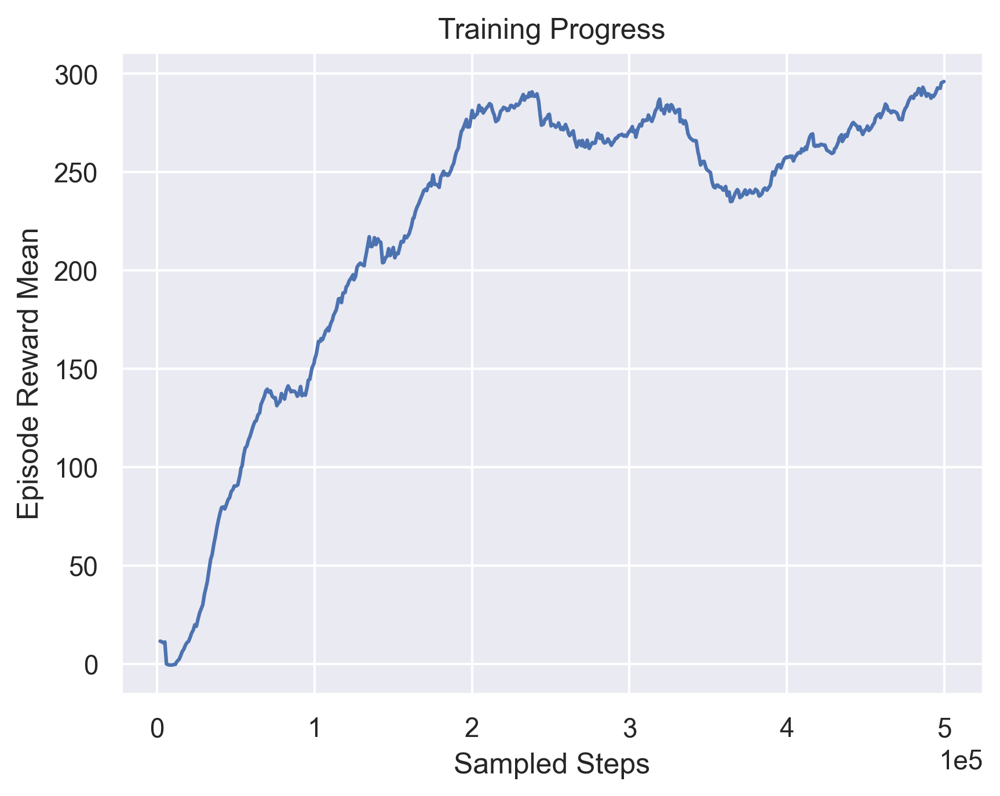

In [16]:
#Regular TD3
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-og-td3/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-og.png', format='png', dpi=300, bbox_inches="tight")

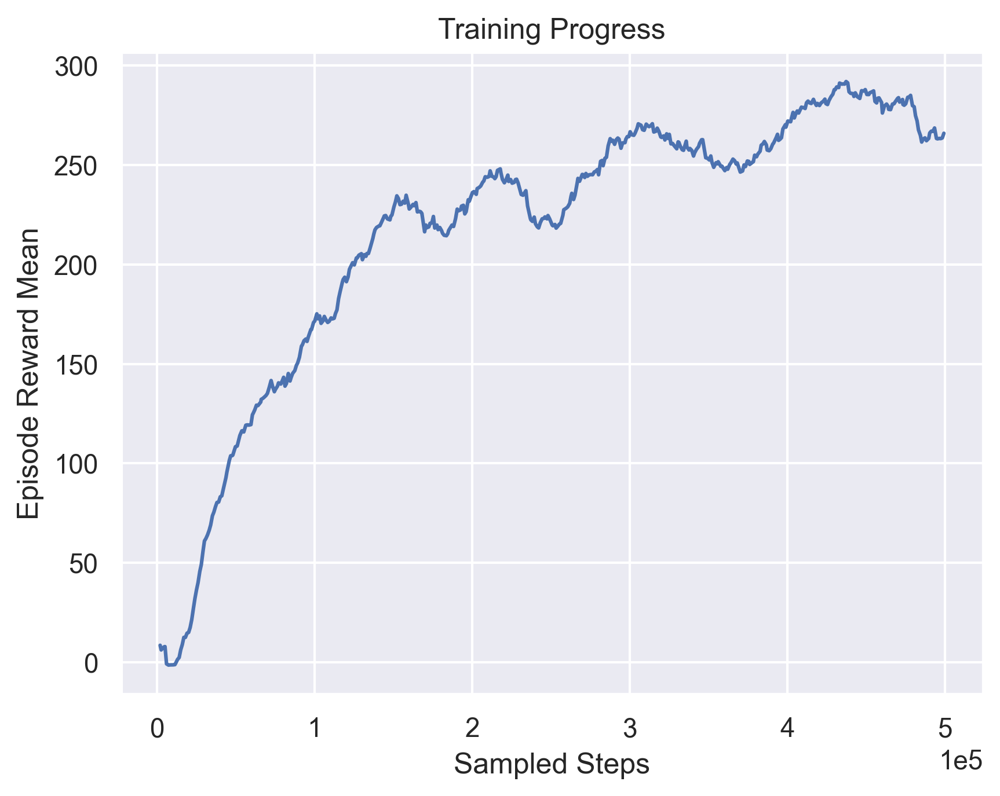

In [17]:
#0.9Q1 + 0.1Q2
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-weighted-td3/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-weighted.png', format='png', dpi=300, bbox_inches="tight")

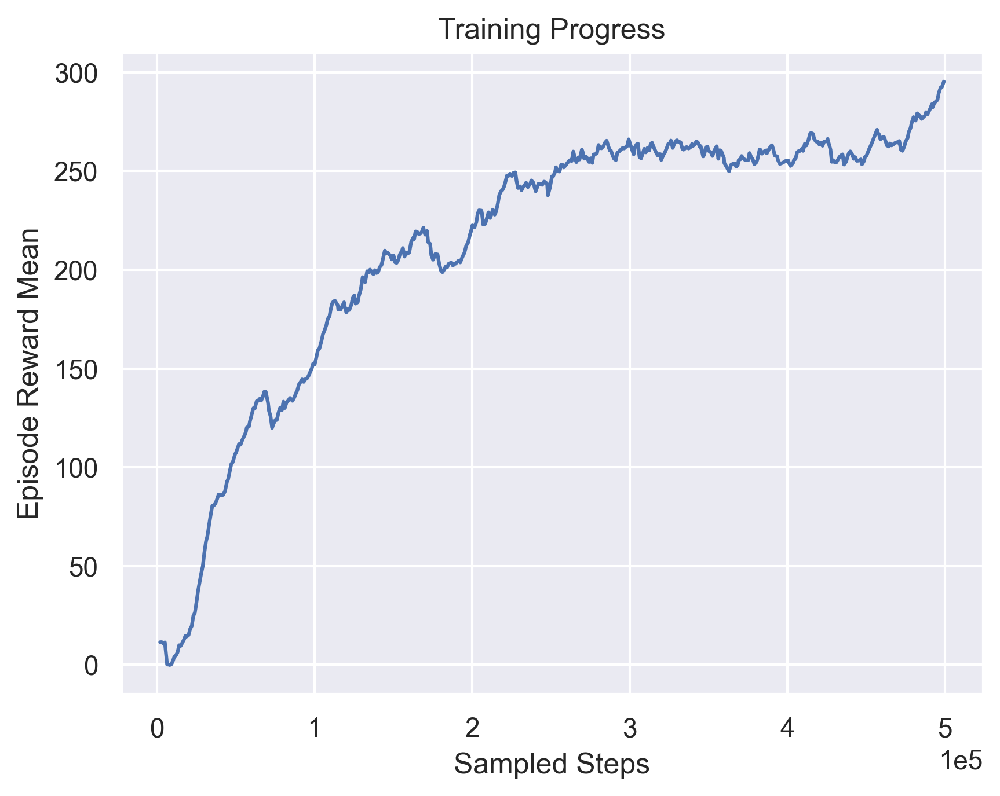

In [18]:
#0.95Q1 + 0.05Q2
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-weighted2-td3/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-weighted2.png', format='png', dpi=300, bbox_inches="tight")

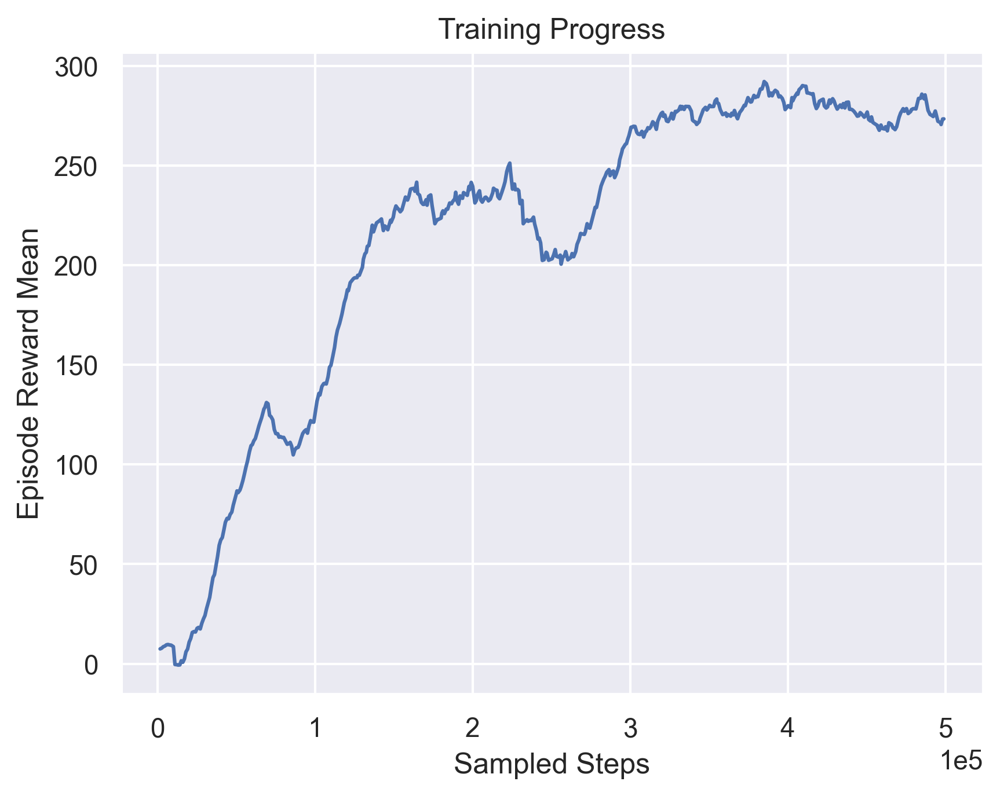

In [19]:
#actor with small conv and dropout
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-small-conv-colab-actor-dropout1d/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-conv-small-actor-dropout.png', format='png', dpi=300, bbox_inches="tight")

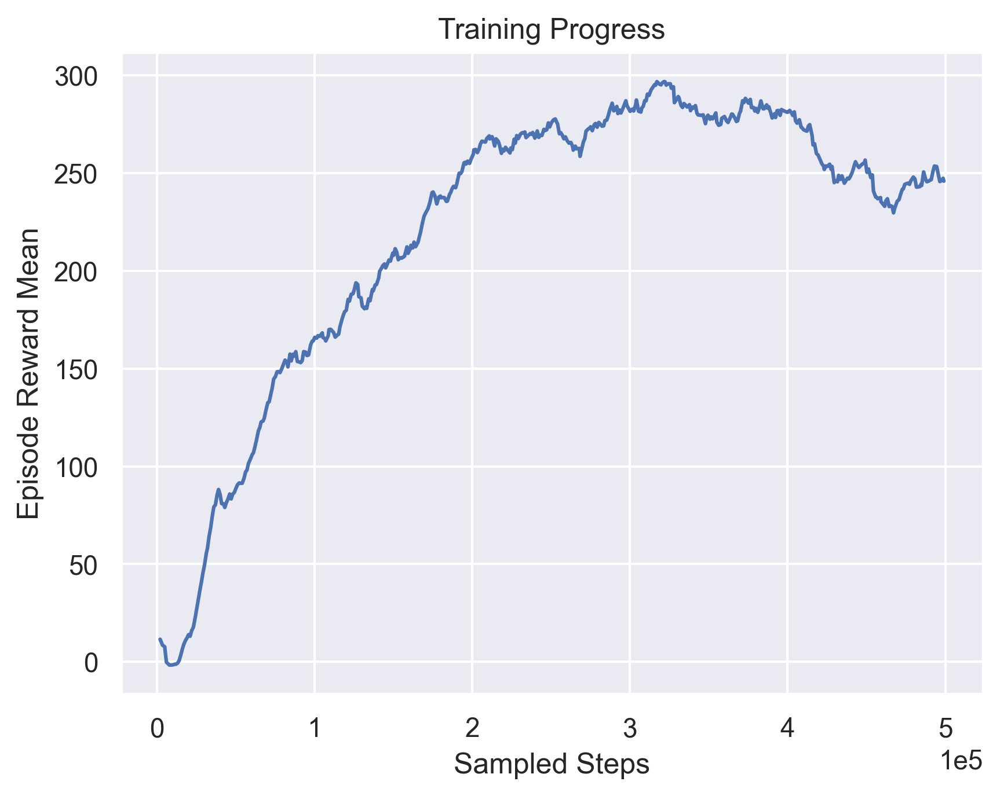

In [24]:
#variable noise with 5000 start
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-noise-reduction-td3/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-noise-reduction-5000.png', format='png', dpi=300, bbox_inches="tight")

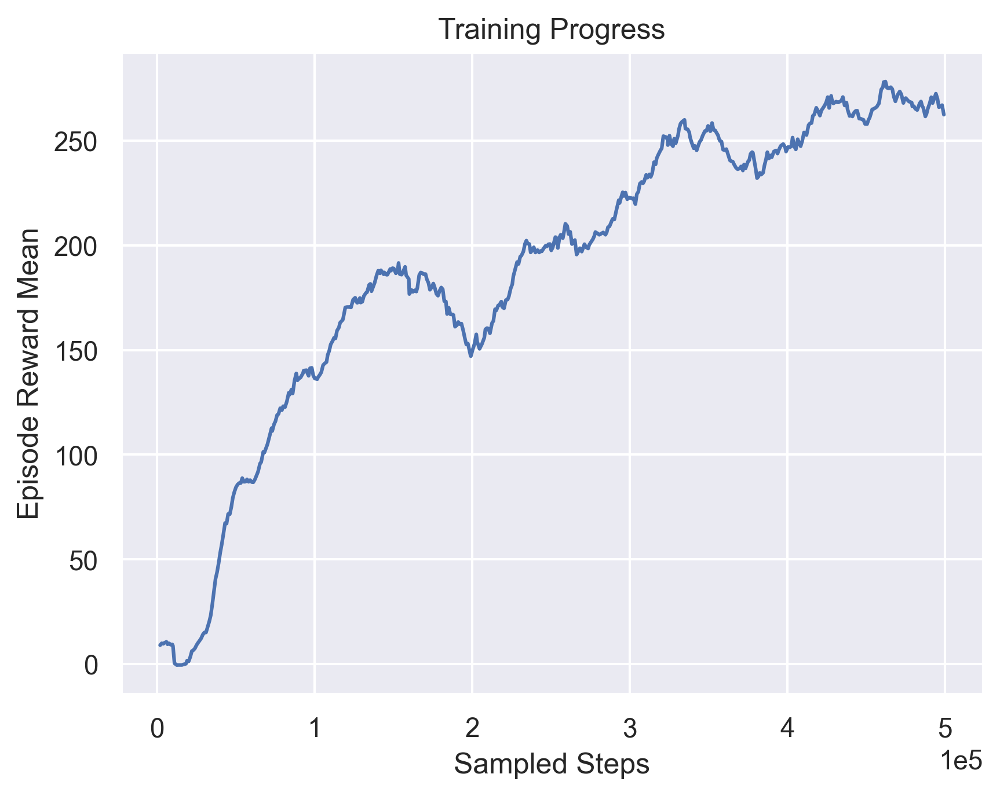

In [25]:
#variable noise with 10000 start
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-noise2-reduction-td3/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-noise-reduction-10000.png', format='png', dpi=300, bbox_inches="tight")

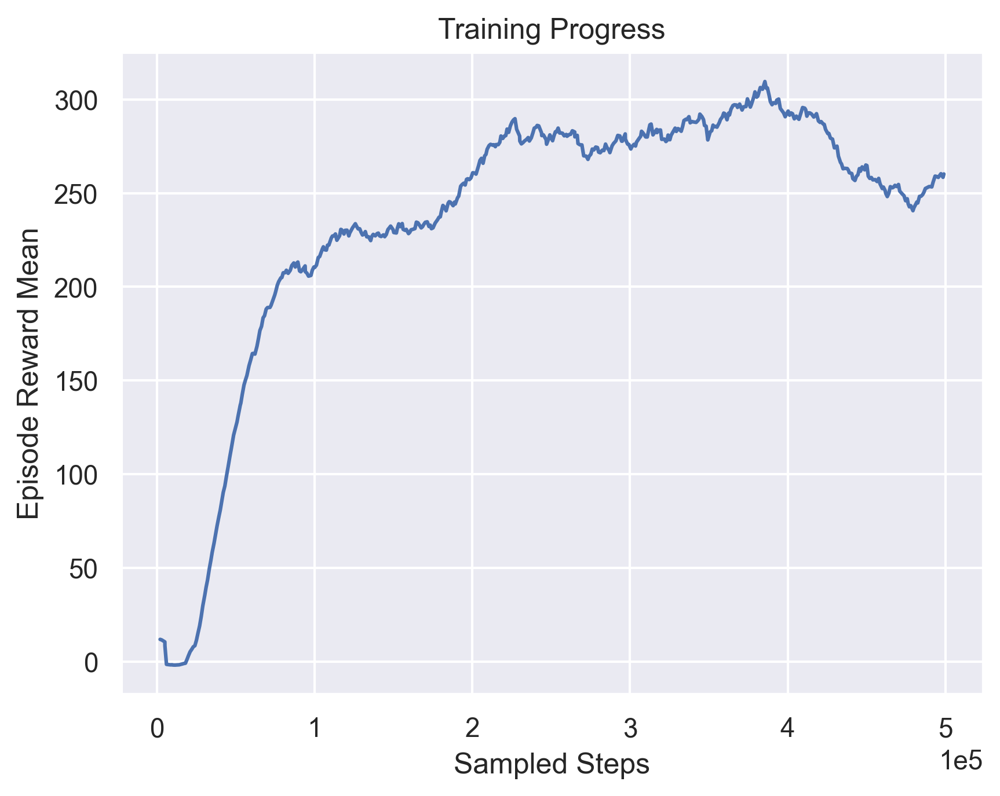

In [26]:
#no noise with 5000 start
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-no-noise-td3/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-no-noise-5000.png', format='png', dpi=300, bbox_inches="tight")

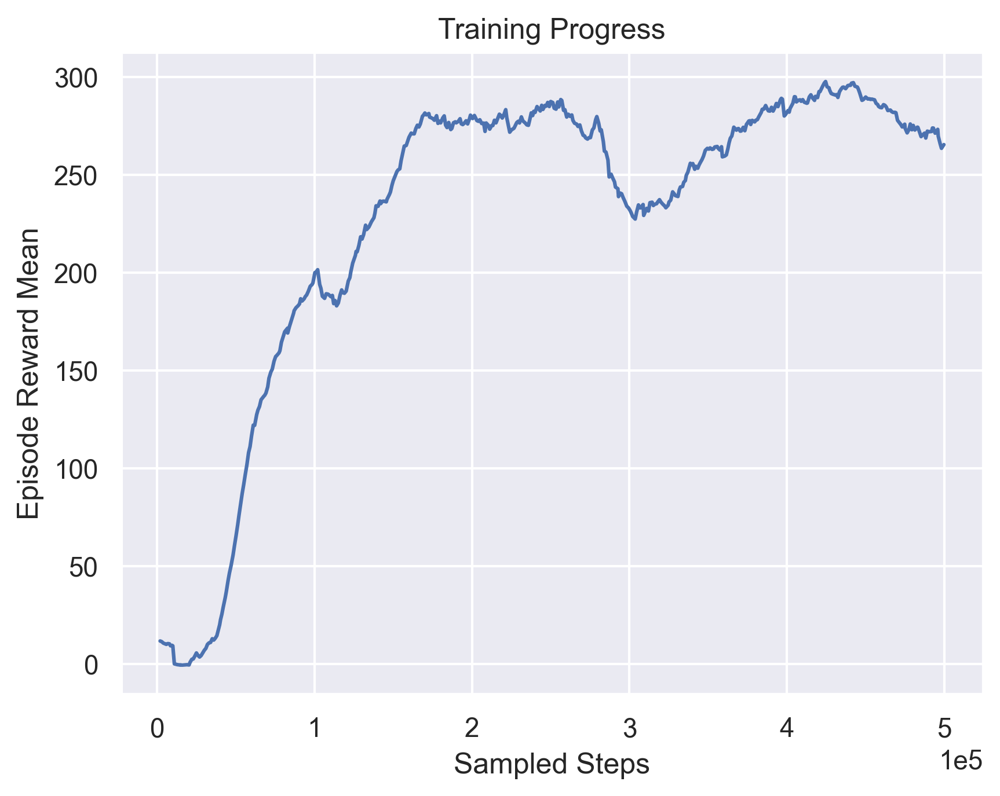

In [27]:
#no noise with 10000 start
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-no-noise2-td3/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-no-noise-10000.png', format='png', dpi=300, bbox_inches="tight")

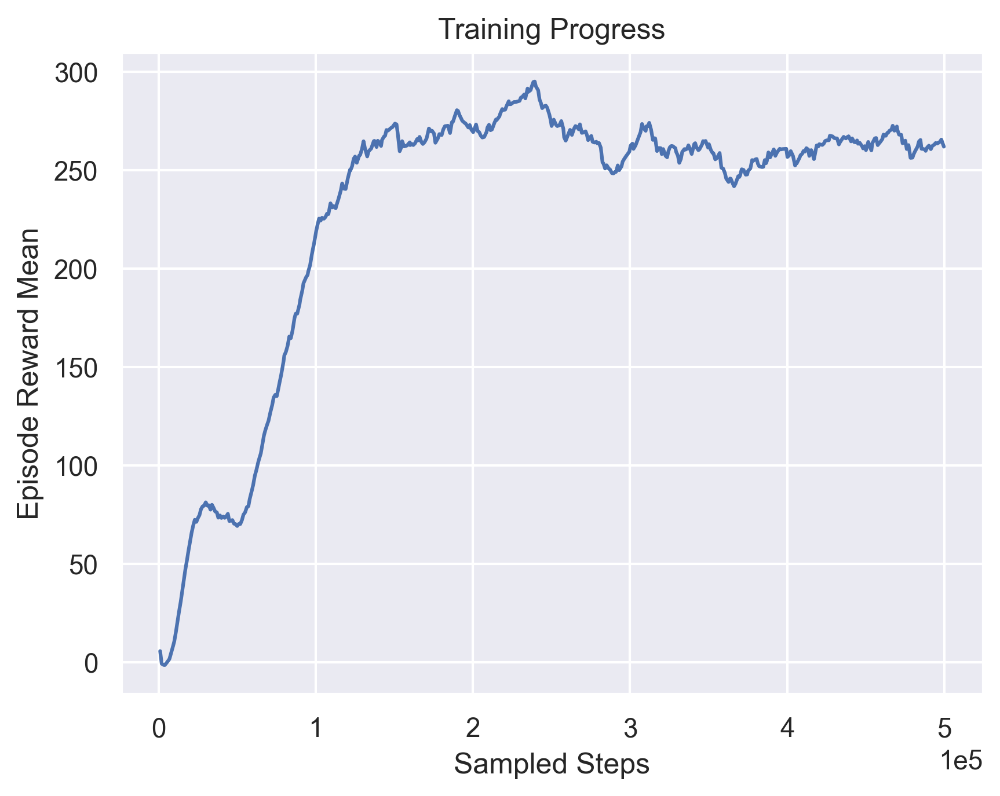

In [28]:
#reducing noise with 1000 start steps
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-noise-reduction-td3-1000/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-noise-reduction-1000.png', format='png', dpi=300, bbox_inches="tight")

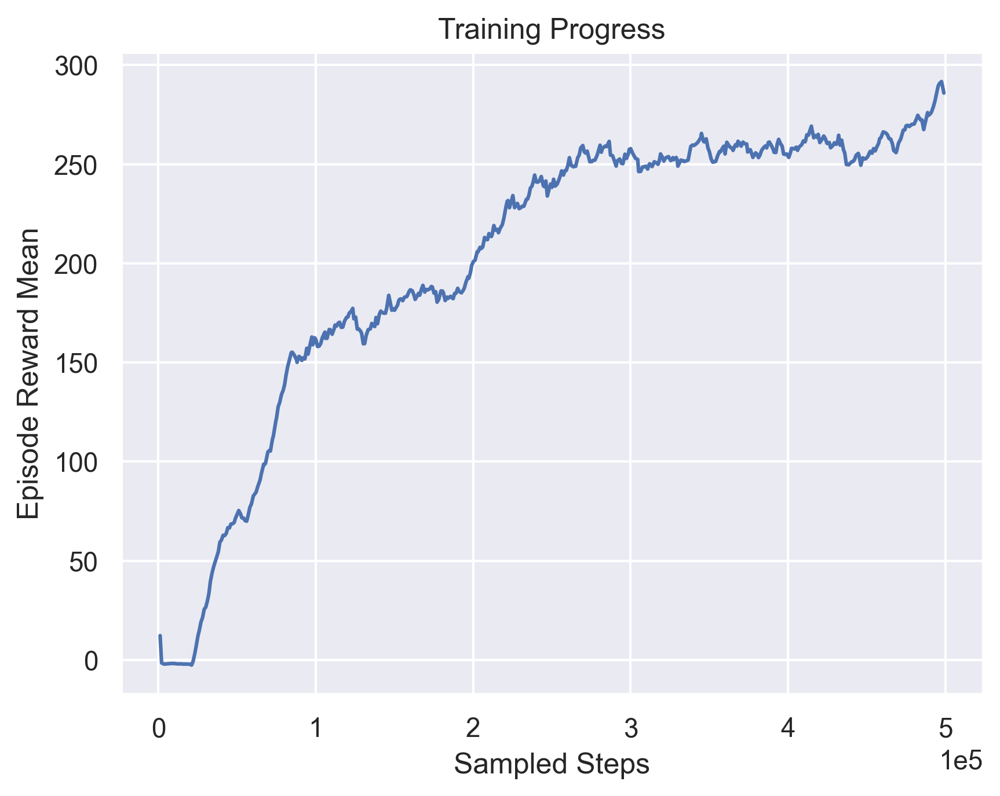

In [31]:
#no with 1000 start steps
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-no-noise-td3-low/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-no-noise-1000.png', format='png', dpi=300, bbox_inches="tight")

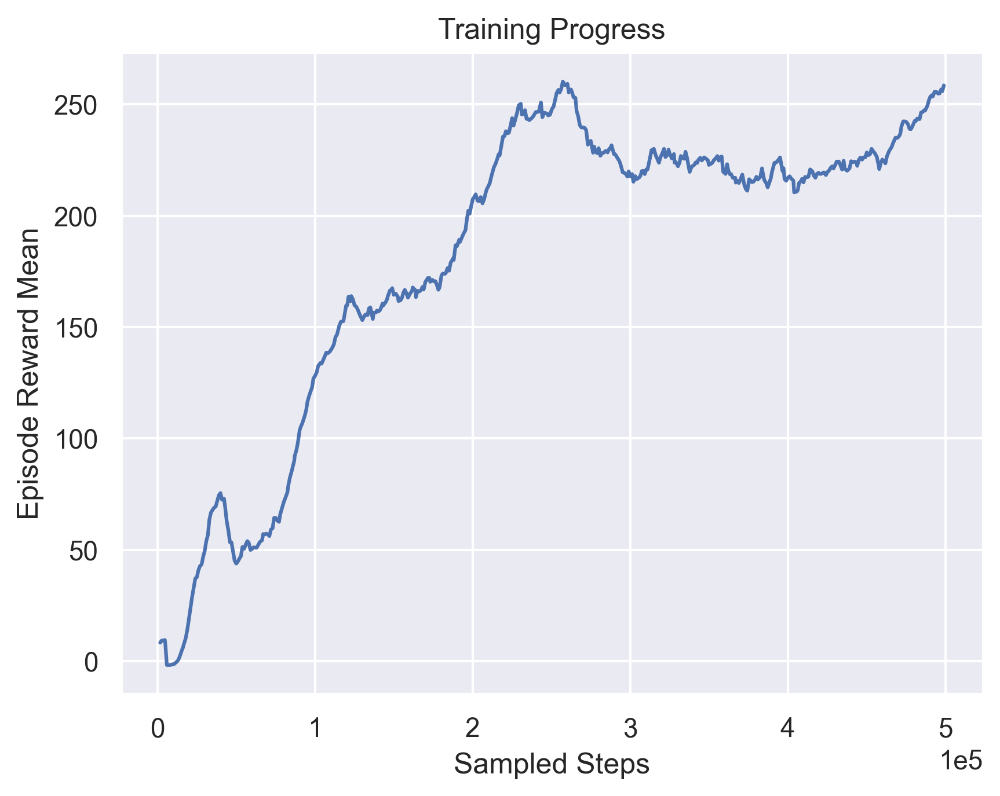

In [32]:
#Conv + dropout + instance norm
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv-dropout-norm-lr/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-conv-dropout-norm-lr.png', format='png', dpi=300, bbox_inches="tight")

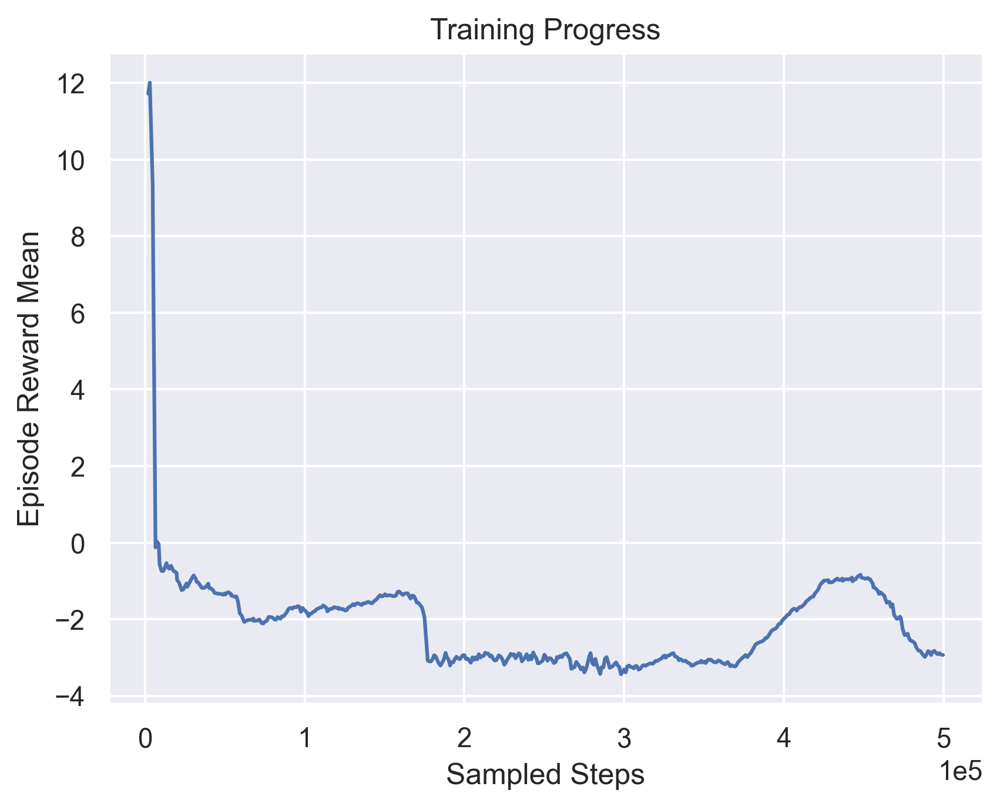

In [33]:
#Conv + dropout + instance norm +lr = 5e-4 => bad
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv-dropout-norm-lr-lesser/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metadrive-test-conv-dropout-norm-lr-lesser.png', format='png', dpi=300, bbox_inches="tight")

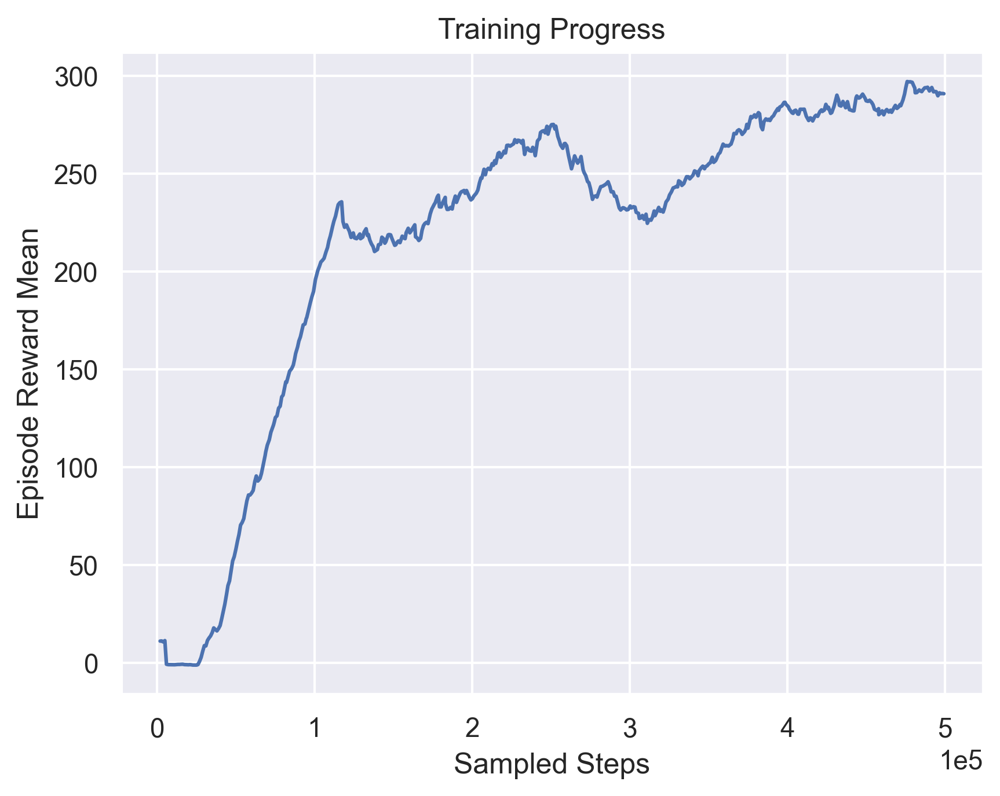

In [35]:
#q1+0.01(q2-q1) for intermediate q
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-reducing-q-diff-td3/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metaDrive-test-reducing-q-diff-td3.png', format='png', dpi=300, bbox_inches="tight")

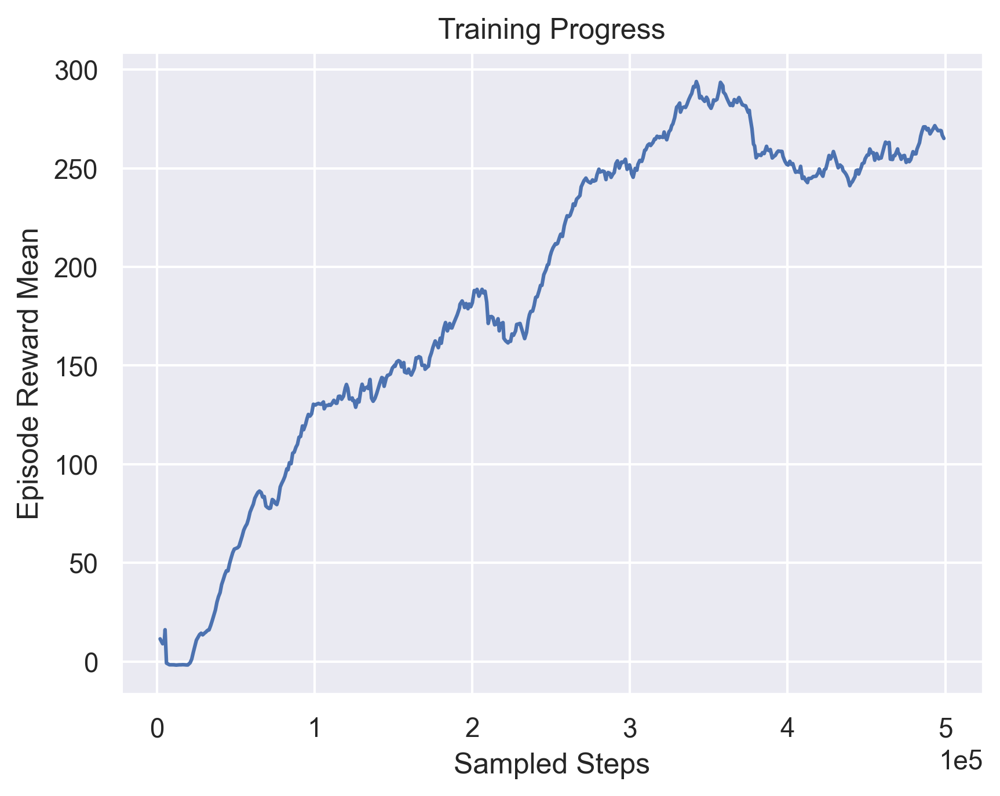

In [36]:
#Actor loss as q1+q2
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-combined-actor-loss/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metaDrive-test-combined-actor-loss.png', format='png', dpi=300, bbox_inches="tight")

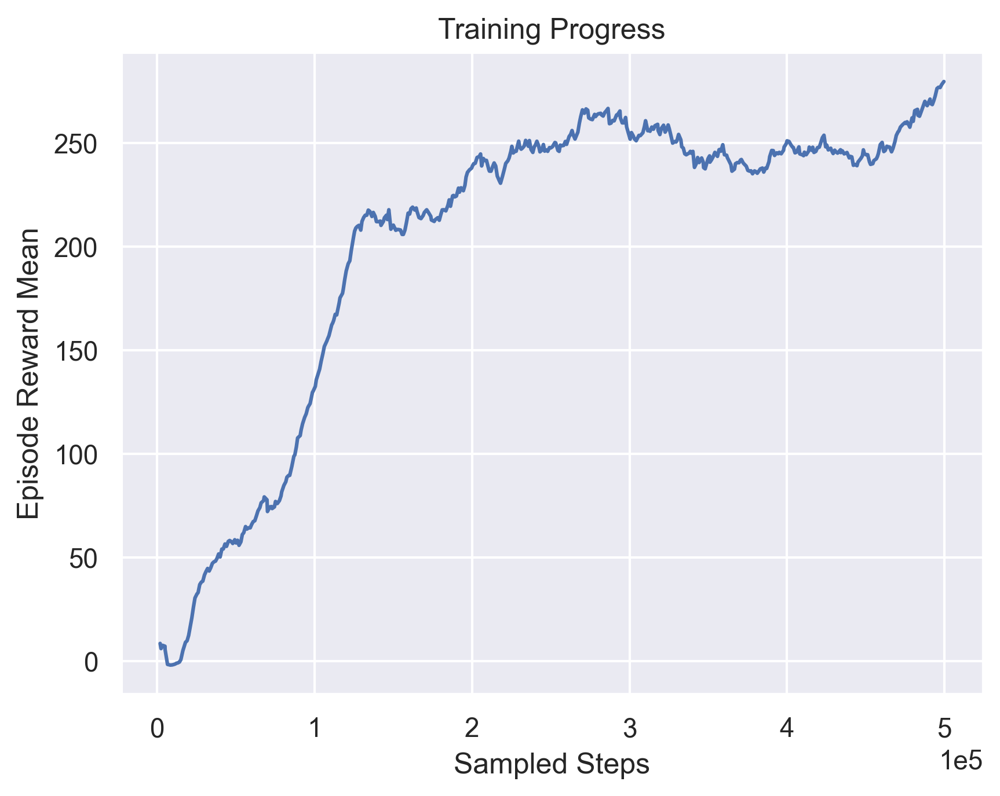

In [37]:
#Conv with leaky relu, adamw, in 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv-dropout-norm-lr-adamW/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metaDrive-test-conv-dropout-norm-lr-adamW.png', format='png', dpi=300, bbox_inches="tight")

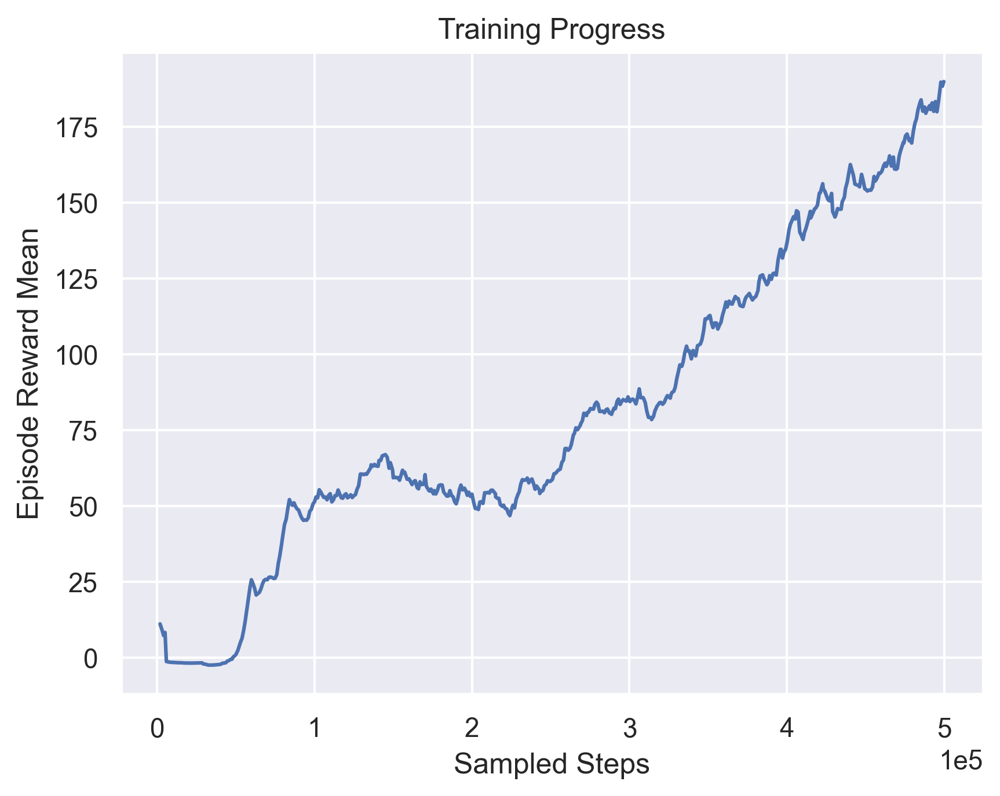

In [38]:
#Conv with adam dropout lr=1e-5
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

progress = pd.read_csv("MetaDrive-test-conv-dropout-norm-lr-1e5/td3/progress.csv")
plt.figure(dpi=300)
sns.set("notebook", "darkgrid")
ax = sns.lineplot(
    data=progress,
    x="total_steps",
    y="episode_reward"
)
ax.set_title("Training Progress")
ax.set_ylabel("Episode Reward Mean")
ax.set_xlabel("Sampled Steps")

ax.ticklabel_format(style='sci', scilimits=(0,0), axis='x')

plt.savefig('metaDrive-test-conv-dropout-norm-lr-1e5.png', format='png', dpi=300, bbox_inches="tight")